In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
from datetime import datetime

# Contexte 

SNCF-Transilien est l’opérateur de trains de banlieue d'Île-de-France. Nous faisons circuler plus de 6 200 trains permettant à 3,2 millions de voyageurs de se déplacer. Ces voyageurs valident leurs cartes à puce sur nos portiques en moyenne 2,3 millions de fois par jour. Le nombre de validations croît de 2015 à 2019 d’environ 6% par an. Mieux anticiper cette augmentation nous aidera à proposer des services plus adaptés et à améliorer la performance de notre exploitation.

# But
Le but de ce challenge pour SNCF-Transilien est de prédire à moyen-long terme le nombre de validations par jour et par gare.

C'est un problème classique de prévision de séries temporelles. La complexité vient de la multiplicité des séries. L'objectif pour SNCF-Transilien est de pouvoir anticiper les volumes de voyageurs à absorber dans les années à venir. SNCF-Transilien est objectivé sur la croissance du volume de validations sur ses gares, l'anticiper et mieux le comprendre est essentiel pour nous.

# Structure des données
Nous utilisons la variable date pour spécifier le jour auquel les validations sont comptabilisées et station pour spécifier la gare donnée. La variable y donne le nombre de validations par jour et par gare.

- Un jeu de données train.csv avec 1 237 971 lignes et 6 colonnes. Il s’agit des données quotidiennes de validations des 448 stations du réseau SNCF-Transilien (comprenant toutes les gares du RER A et du RER B) entre le 1er janvier 2015 et le 31 décembre 2022 (soit 2922 jours).

- Un jeu de données test.csv avec 78 652 lignes et 6 colonnes. Il s’agit des données quotidiennes de validations des 448 stations du réseau SNCF-Transilien (comprenant toutes les gares du RER A et du RER B) entre le 1er janvier 2023 et le 30 juin 2023 (soit 181 jours).

Nous vous demandons de prédire le nombre de validations (variable y) par jour pour toutes les gares de SNCF-Transilien entre le 1er janvier 2023 et le 30 juin 2023. Nous fournissons quelques variables exogènes qui pourront être enrichies.


Variables contextuelles :
- date : la date du jour où les validations ont été collectées au format YYYY-MM-DD ;

- station : identifiant de la gare anonymisé en 3 caractères (7RP, J3V…) ;

- job : indicatrice valant 1 si le jour est un JOB (Jour Ouvrable de Base), c’est-à-dire un lundi, mardi, mercredi, jeudi ou vendredi, 0 sinon ;

- ferie : indicatrice valant 1 si le jour est férié, 0 sinon ;

- vacances : indicatrice valant 1 si le jour correspond à un jour de vacances scolaires, 0 sinon.

# Métrique

La mesure de l'erreur se fera en Mean Absolute Percentage Error (MAPE), c'est-à-dire : 

$ \frac{1}{n} \displaystyle \sum _{i=1} ^n \frac{|y_i - \hat{y _i}|}{y_i} $ où n correspond au nombre de couples gare x date disponibles dans le jeu de données test (test.csv).

In [2]:
df = pd.read_csv('/Users/augustincablant/Desktop/challenge_SNCF/train_f_x.csv')
y = pd.read_csv('/Users/augustincablant/Desktop/challenge_SNCF/y_train_sncf.csv')
df.sample(5)

,date,station,job,ferie,vacances
696435,2018-03-18,RVB,0,0,0
893781,2016-02-23,EVR,1,0,1
507175,2018-07-13,8QR,1,0,1
329451,2020-02-09,BC6,0,0,1
99036,2018-06-03,ROF,0,0,0


In [3]:
df.shape, y.shape

((1229863, 5), (1229863, 2))

In [4]:
# Les différents types de stations (identifiant de la gare)
len(df['station'].unique())

439

In [5]:
df['date'].min(), df['date'].max()

('2015-01-01', '2022-12-31')

In [8]:
y.sample(5)

,index,y
270411,2016-09-07_P3G,6204
314054,2015-10-08_MPO,1566
242867,2022-12-06_N6I,27091
769289,2016-01-20_B65,3518
1088999,2017-12-27_B61,8582


In [9]:
def transform_y(dataset):
    test = dataset
    test['date'] = 0 
    test['station'] = 0

    for i in test.index.to_list():
        row = test['index'][i]
        test['date'][i] = row.split('_')[0]
        test['station'][i] = row.split('_')[1]
    return test

y = transform_y(y)
y.head()

/var/folders/bt/r1dg46ys21lb57m4n4x11m6c0000gn/T/ipykernel_19913/2598496531.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['date'][i] = row.split('_')[0]
/var/folders/bt/r1dg46ys21lb57m4n4x11m6c0000gn/T/ipykernel_19913/2598496531.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['station'][i] = row.split('_')[1]


,index,y,date,station
0,2015-01-01_1J7,7,2015-01-01,1J7
1,2015-01-01_O2O,0,2015-01-01,O2O
2,2015-01-01_8QR,9,2015-01-01,8QR
3,2015-01-01_UMC,9,2015-01-01,UMC
4,2015-01-01_FK3,28,2015-01-01,FK3


In [18]:
df_train = pd.merge(df, y, how = 'left', on = ['date', 'station'])
df_train.head()

,date,station,job,ferie,vacances,index,y
0,2015-01-01,1J7,1,1,1,2015-01-01_1J7,7
1,2015-01-01,O2O,1,1,1,2015-01-01_O2O,0
2,2015-01-01,8QR,1,1,1,2015-01-01_8QR,9
3,2015-01-01,UMC,1,1,1,2015-01-01_UMC,9
4,2015-01-01,FK3,1,1,1,2015-01-01_FK3,28


In [12]:
df_train.shape

(1229863, 7)

In [19]:
df_train['date'] = pd.to_datetime(df_train['date'])
df_train.head()

,date,station,job,ferie,vacances,index,y
0,2015-01-01,1J7,1,1,1,2015-01-01_1J7,7
1,2015-01-01,O2O,1,1,1,2015-01-01_O2O,0
2,2015-01-01,8QR,1,1,1,2015-01-01_8QR,9
3,2015-01-01,UMC,1,1,1,2015-01-01_UMC,9
4,2015-01-01,FK3,1,1,1,2015-01-01_FK3,28


/var/folders/bt/r1dg46ys21lb57m4n4x11m6c0000gn/T/ipykernel_19913/1283171517.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_df.sort_index(inplace=True)


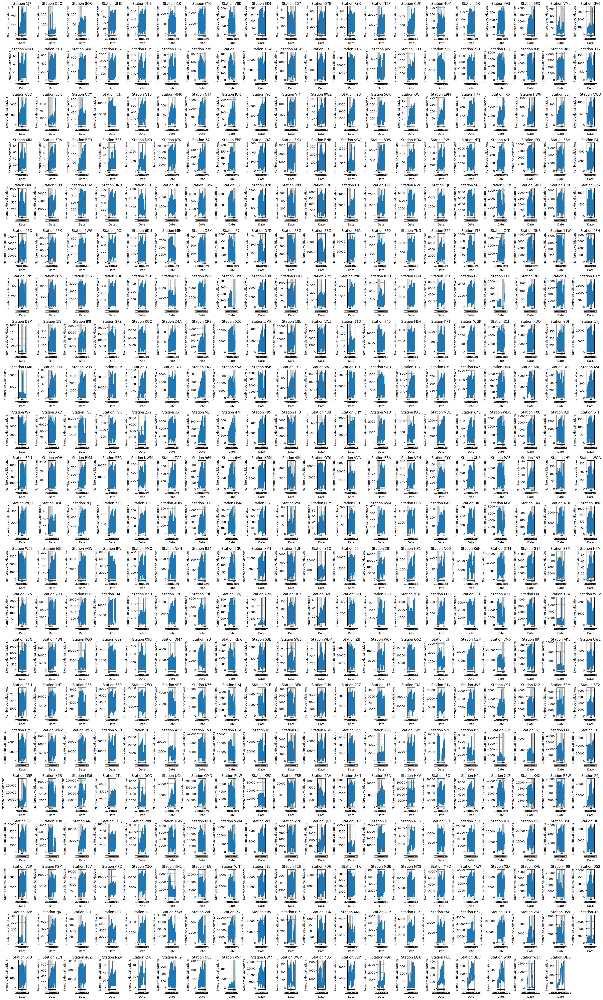

In [26]:
n_rows = 22 
n_cols = 20

stations = df_train['station'].unique()

total_stations = len(stations)

plt.figure(figsize=(30, 50))


for i, station in enumerate(stations):
    sub_df = df_train[df_train['station'] == station]
    sub_df.set_index('date', inplace=True)
    sub_df.sort_index(inplace=True)

    row_index = i // n_cols + 1
    col_index = i % n_cols + 1

    plt.subplot(n_rows, n_cols, i + 1)
    
    plt.plot(sub_df.index, sub_df['y'])
    plt.title(f'Station {station}')
    plt.xlabel('Date')
    plt.ylabel('Nombre de validations')
    plt.grid(True)


plt.tight_layout()

plt.show()

## Si on veut le détail :

/var/folders/bt/r1dg46ys21lb57m4n4x11m6c0000gn/T/ipykernel_19913/990113131.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_df.sort_index(inplace = True)


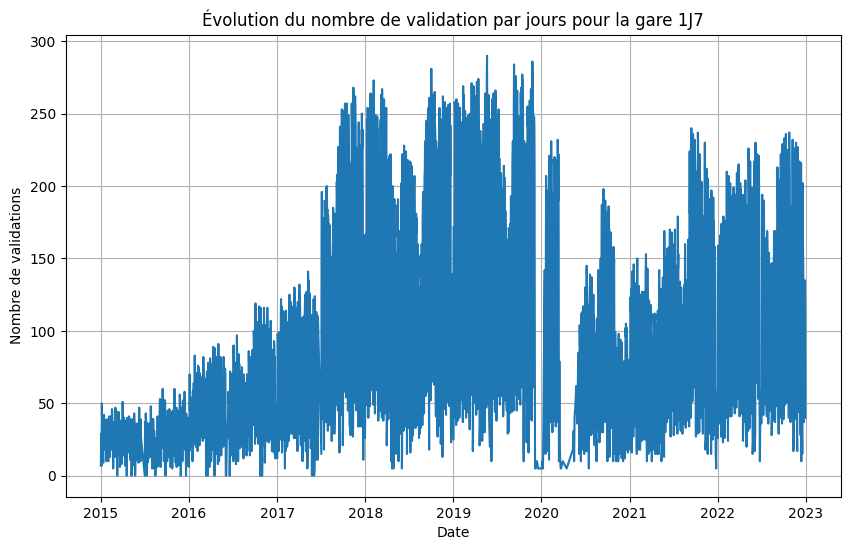

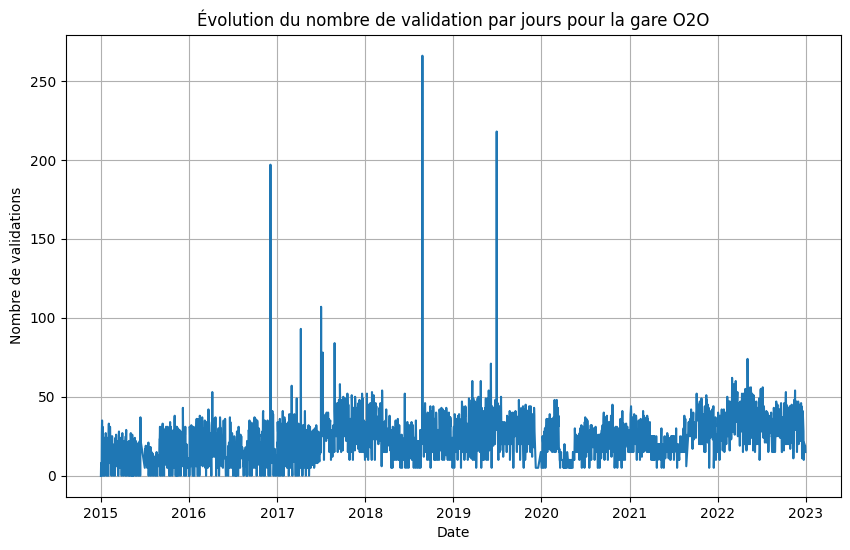

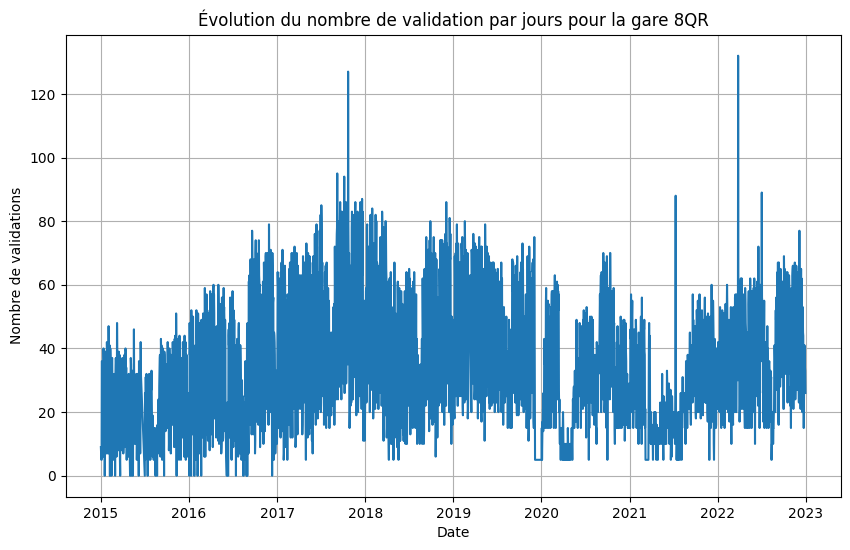

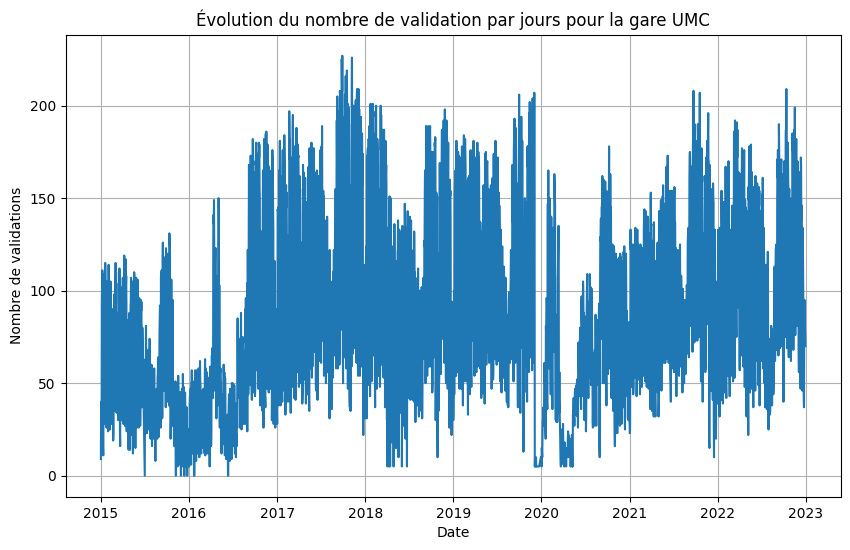

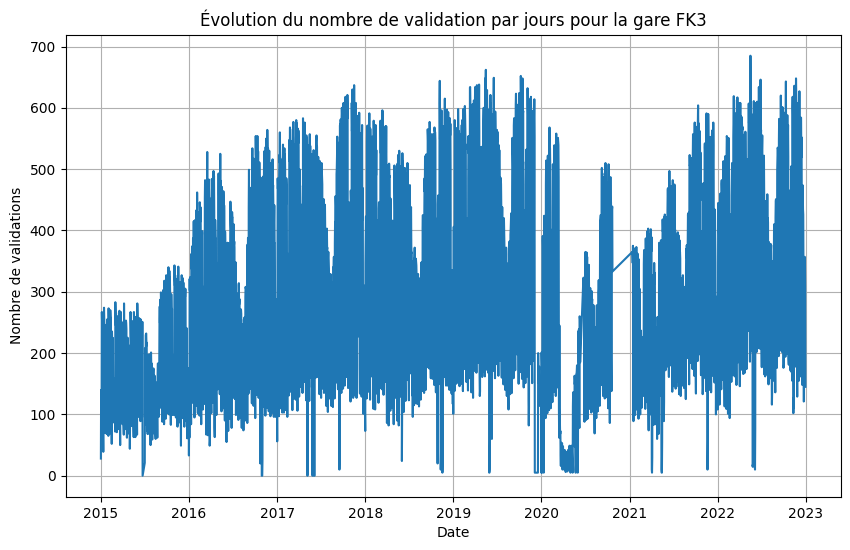

...

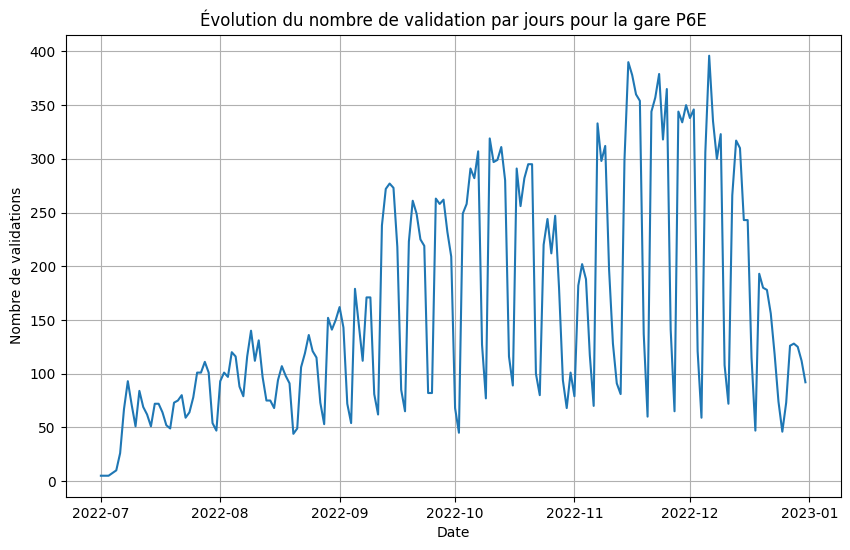

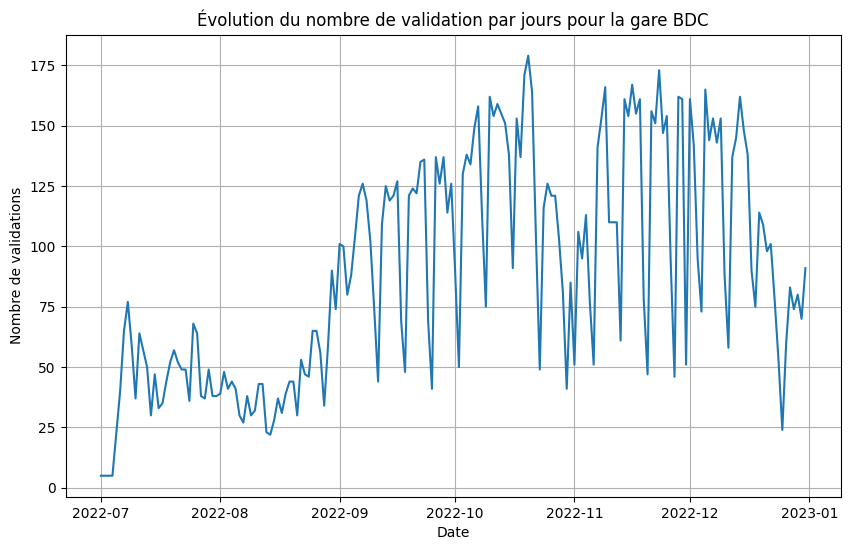

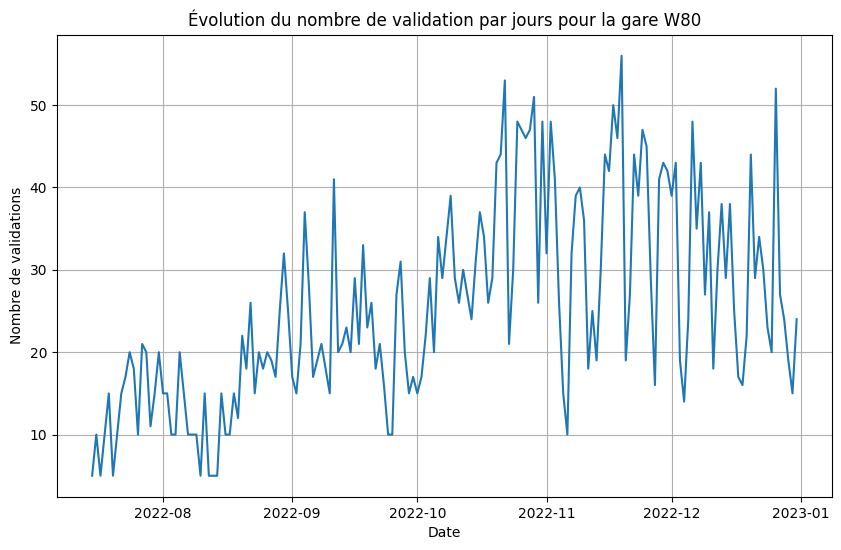

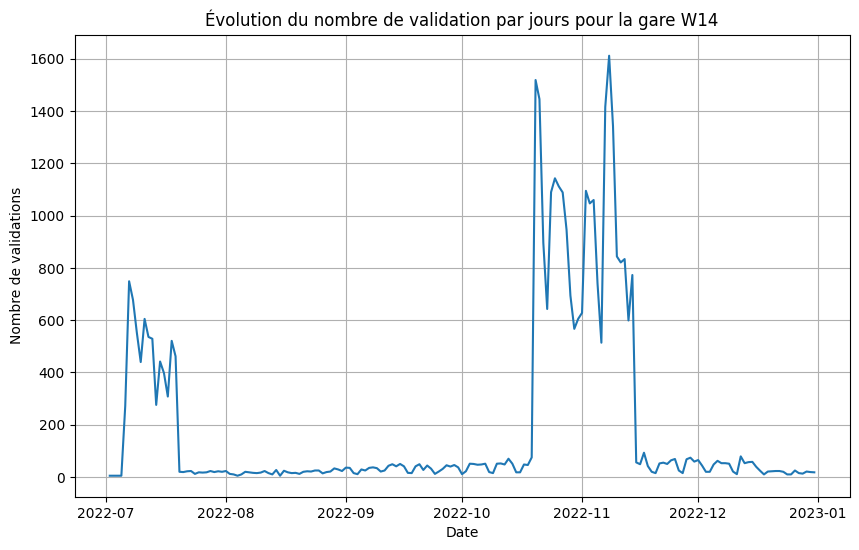

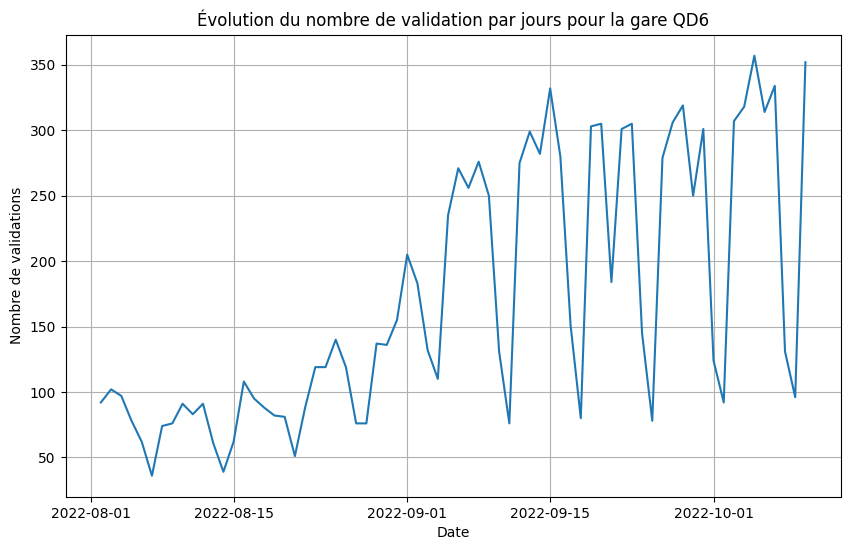

In [25]:
for station in list(df_train['station'].unique()):
    sub_df = df_train[df_train['station']==station]
    sub_df.set_index('date', inplace = True)
    sub_df.sort_index(inplace = True)
    plt.figure(figsize=(10, 6))
    plt.plot(sub_df.index, sub_df['y'])
    plt.title(f'Évolution du nombre de validation par jours pour la gare {station}')
    plt.xlabel('Date')
    plt.ylabel('Nombre de validations')
    plt.grid(True)
    plt.show()
    